In [1]:
import torch
import torch.nn as nn
import torch.optim as optim
from torch.utils.data import Dataset, DataLoader
from torchvision import transforms
from PIL import Image
import numpy as np
import matplotlib.pyplot as plt
import os

In [2]:
class UNet(nn.Module):
    def __init__(self, in_channels=3, out_channels=3):
        super(UNet, self).__init__()
        def CBR(in_c, out_c):
            return nn.Sequential(
                nn.Conv2d(in_c, out_c, 3, padding=1),
                nn.BatchNorm2d(out_c),
                nn.ReLU(inplace=True),
                nn.Conv2d(out_c, out_c, 3, padding=1),
                nn.BatchNorm2d(out_c),
                nn.ReLU(inplace=True),
            )
        self.enc1 = CBR(in_channels, 64)
        self.enc2 = CBR(64, 128)
        self.enc3 = CBR(128, 256)
        self.enc4 = CBR(256, 512)
        self.pool = nn.MaxPool2d(2)
        self.center = CBR(512, 1024)
        self.up4 = nn.ConvTranspose2d(1024, 512, 2, stride=2)
        self.dec4 = CBR(1024, 512)
        self.up3 = nn.ConvTranspose2d(512, 256, 2, stride=2)
        self.dec3 = CBR(512, 256)
        self.up2 = nn.ConvTranspose2d(256, 128, 2, stride=2)
        self.dec2 = CBR(256, 128)
        self.up1 = nn.ConvTranspose2d(128, 64, 2, stride=2)
        self.dec1 = CBR(128, 64)
        self.out_conv = nn.Conv2d(64, out_channels, 1)

    def forward(self, x):
        e1 = self.enc1(x)
        e2 = self.enc2(self.pool(e1))
        e3 = self.enc3(self.pool(e2))
        e4 = self.enc4(self.pool(e3))
        c = self.center(self.pool(e4))
        d4 = self.dec4(torch.cat([self.up4(c), e4], 1))
        d3 = self.dec3(torch.cat([self.up3(d4), e3], 1))
        d2 = self.dec2(torch.cat([self.up2(d3), e2], 1))
        d1 = self.dec1(torch.cat([self.up1(d2), e1], 1))
        out = self.out_conv(d1)
        return out

In [3]:
def rgb_to_class(mask):
    """Convert RGB mask to class indices: 0=background, 1=nucleus, 2=border"""
    class_mask = np.zeros((mask.shape[0], mask.shape[1]), dtype=np.uint8)
    # background: black
    class_mask[(mask[:,:,0]==0) & (mask[:,:,1]==0) & (mask[:,:,2]==0)] = 0
    # nuclei: blue
    class_mask[(mask[:,:,0]==0) & (mask[:,:,1]==0) & (mask[:,:,2]==255)] = 1
    # border: green
    class_mask[(mask[:,:,0]==0) & (mask[:,:,1]==255) & (mask[:,:,2]==0)] = 2
    return class_mask

In [4]:
class HistopathologyDataset(Dataset):
    def __init__(self, images_dir, masks_dir, img_size=256, augment=False):
        self.images_dir = images_dir
        self.masks_dir = masks_dir
        self.img_size = img_size
        self.images = sorted(os.listdir(images_dir))
        self.masks = sorted(os.listdir(masks_dir))
        self.augment = augment
        self.img_transform = transforms.Compose([
            transforms.Resize((img_size, img_size)),
            transforms.ToTensor(),
        ])
        self.mask_transform = transforms.Compose([
            transforms.Resize((img_size, img_size), interpolation=transforms.InterpolationMode.NEAREST),
        ])

    def __len__(self):
        return len(self.images)

    def __getitem__(self, idx):
        img_path = os.path.join(self.images_dir, self.images[idx])
        mask_path = os.path.join(self.masks_dir, self.masks[idx])
        image = Image.open(img_path).convert("RGB")
        mask = np.array(Image.open(mask_path).convert("RGB"))  # (H, W, 3)
        mask = rgb_to_class(mask)  # (H, W), 0/1/2
        mask = Image.fromarray(mask)
        mask = self.mask_transform(mask)
        mask = torch.as_tensor(np.array(mask), dtype=torch.long)  # shape: [H, W], long/int

        # Simple horizontal flip augmentation
        if self.augment and np.random.rand() > 0.5:
            image = transforms.functional.hflip(image)
            mask = transforms.functional.hflip(mask)
        image = self.img_transform(image)  # shape: [3, H, W]
        return image, mask

In [5]:
def multiclass_dice_coeff(preds, targets, num_classes=3, epsilon=1e-6):
    preds = torch.argmax(preds, dim=1)  # shape: [B, H, W]
    dice_scores = []
    for c in range(num_classes):
        pred_c = (preds == c).float()
        target_c = (targets == c).float()
        intersection = (pred_c * target_c).sum()
        union = pred_c.sum() + target_c.sum()
        dice = (2. * intersection + epsilon) / (union + epsilon)
        dice_scores.append(dice.item())
    return dice_scores  # List: one dice score per class

def multiclass_iou_score(preds, targets, num_classes=3, epsilon=1e-6):
    preds = torch.argmax(preds, dim=1)
    iou_scores = []
    for c in range(num_classes):
        pred_c = (preds == c).float()
        target_c = (targets == c).float()
        intersection = (pred_c * target_c).sum()
        union = ((pred_c + target_c) > 0).float().sum()
        iou = (intersection + epsilon) / (union + epsilon)
        iou_scores.append(iou.item())
    return iou_scores

In [11]:
# Hyperparameters
epochs = 100
batch_size = 4
lr = 1e-3
device = 'cuda' if torch.cuda.is_available() else 'cpu'

# Paths (update these!)
images_dir = r'G:\COMPUTER VISION\U-Net_Dataset\data\images_all'
masks_dir = r'G:\COMPUTER VISION\U-Net_Dataset\data\masks_all'

# Data
dataset = HistopathologyDataset(images_dir, masks_dir, img_size=256, augment=True)
train_size = int(0.8 * len(dataset))
val_size = len(dataset) - train_size
train_set, val_set = torch.utils.data.random_split(dataset, [train_size, val_size])
train_loader = DataLoader(train_set, batch_size=batch_size, shuffle=True)
val_loader = DataLoader(val_set, batch_size=1)

# Model, loss, optimizer
model = UNet(out_channels=3).to(device)
criterion = nn.CrossEntropyLoss()
optimizer = optim.Adam(model.parameters(), lr=lr)

for epoch in range(epochs):
    model.train()
    total_loss = 0
    for images, masks in train_loader:
        images, masks = images.to(device), masks.to(device)
        optimizer.zero_grad()
        outputs = model(images)           # [B, 3, H, W]
        loss = criterion(outputs, masks)  # masks: [B, H, W]
        loss.backward()
        optimizer.step()
        total_loss += loss.item()
    avg_loss = total_loss / len(train_loader)

    # Validation
    model.eval()
    val_loss = 0
    dice_scores = np.zeros(3)
    iou_scores = np.zeros(3)
    with torch.no_grad():
        for images, masks in val_loader:
            images, masks = images.to(device), masks.to(device)
            outputs = model(images)
            loss = criterion(outputs, masks)
            val_loss += loss.item()
            dice = multiclass_dice_coeff(outputs, masks)
            iou = multiclass_iou_score(outputs, masks)
            dice_scores += np.array(dice)
            iou_scores += np.array(iou)
    num_val = len(val_loader)
    avg_val_loss = val_loss / num_val
    avg_dice = dice_scores / num_val
    avg_iou = iou_scores / num_val

    print(
        f"Epoch {epoch+1}/{epochs}, Train Loss: {avg_loss:.4f}, "
        f"Val Loss: {avg_val_loss:.4f}, "
        f"Dice (bg,nuc,border): {avg_dice}, "
        f"IoU (bg,nuc,border): {avg_iou}"
    )

Epoch 1/100, Train Loss: 0.3886, Val Loss: 0.3245, Dice (bg,nuc,border): [0.93186099 0.58710904 0.13302753], IoU (bg,nuc,border): [0.88082385 0.46557423 0.13302753]
Epoch 2/100, Train Loss: 0.2712, Val Loss: 0.2682, Dice (bg,nuc,border): [0.9416027  0.69633253 0.13302753], IoU (bg,nuc,border): [0.89592735 0.57451414 0.13302753]
Epoch 3/100, Train Loss: 0.2562, Val Loss: 0.2749, Dice (bg,nuc,border): [0.93612056 0.64196947 0.13302753], IoU (bg,nuc,border): [0.88937437 0.53086779 0.13302753]
Epoch 4/100, Train Loss: 0.2515, Val Loss: 0.3068, Dice (bg,nuc,border): [0.92708909 0.60088241 0.13302753], IoU (bg,nuc,border): [0.87835672 0.48974596 0.13302753]
Epoch 5/100, Train Loss: 0.2227, Val Loss: 0.2544, Dice (bg,nuc,border): [0.94041523 0.60780933 0.13302753], IoU (bg,nuc,border): [0.89379513 0.4943844  0.13302753]
Epoch 6/100, Train Loss: 0.2261, Val Loss: 0.2955, Dice (bg,nuc,border): [0.91247353 0.62574793 0.13302753], IoU (bg,nuc,border): [0.85688903 0.49873683 0.13302753]
Epoch 7/10

In [12]:
# -------------
# Dice & IoU Score Benchmarks for Segmentation:
#
# Dice Coefficient     IoU (Jaccard)      Interpretation
# -------------------------------------------------------
# 0.90 – 1.00          0.81 – 1.00        Excellent (near-perfect match)
# 0.80 – 0.90          0.65 – 0.81        Very Good
# 0.70 – 0.80          0.50 – 0.65        Good
# 0.60 – 0.70          0.36 – 0.50        Fair/Usable (may need review)
# < 0.60               < 0.36             Poor (usually not acceptable)
# -------------------------------------------------------
# Source: OpenAI ChatGPT, Medical Image Segmentation Practice
# -------------

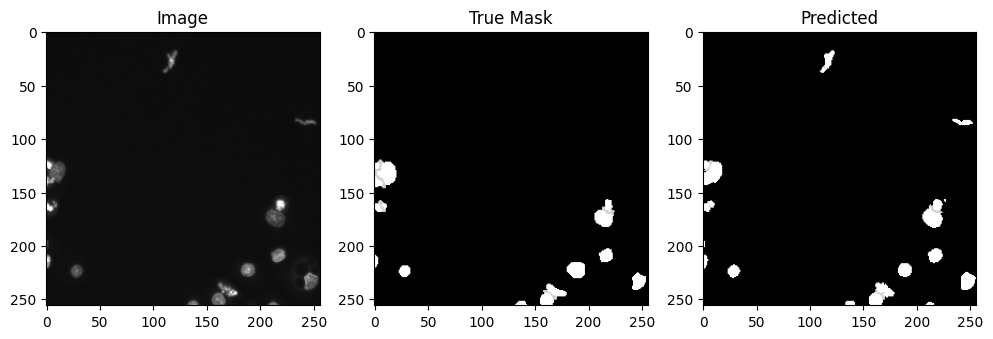

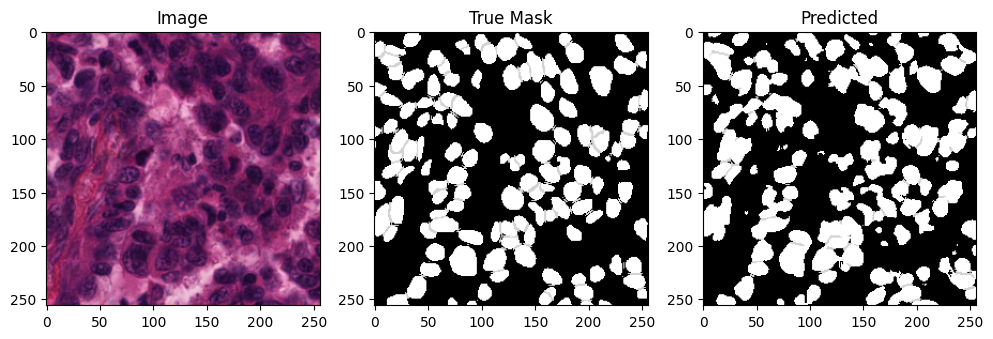

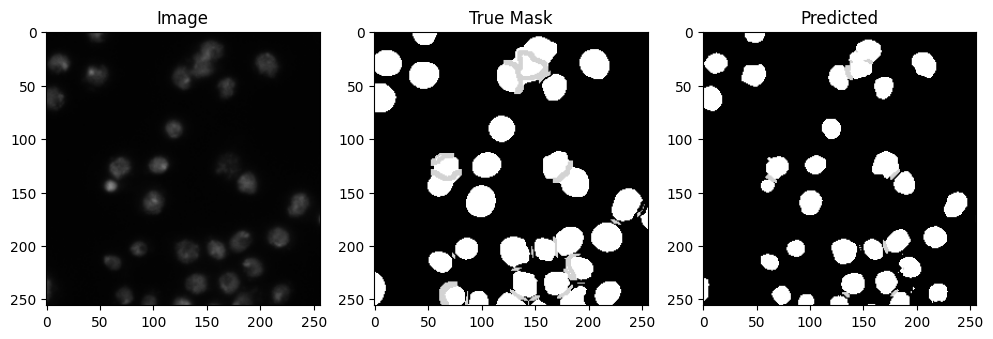

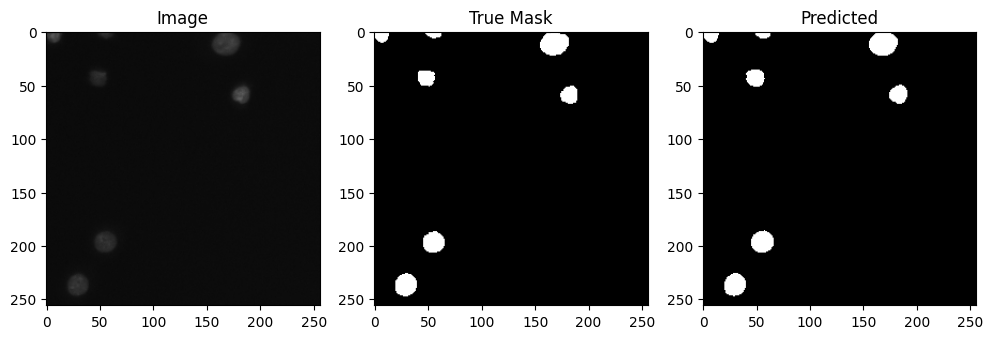

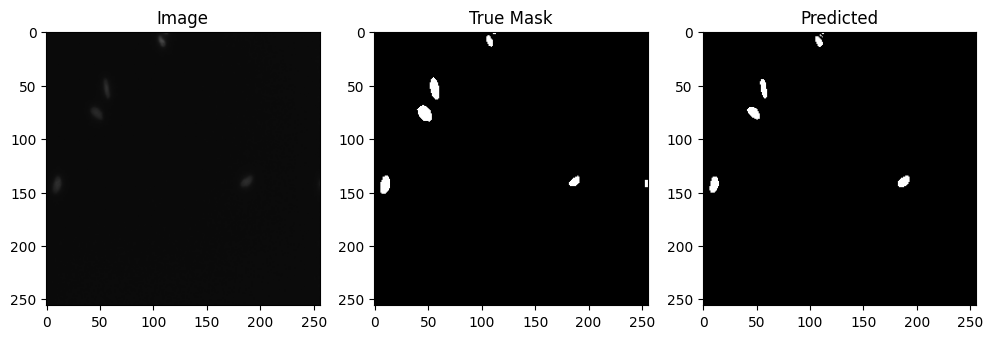

...

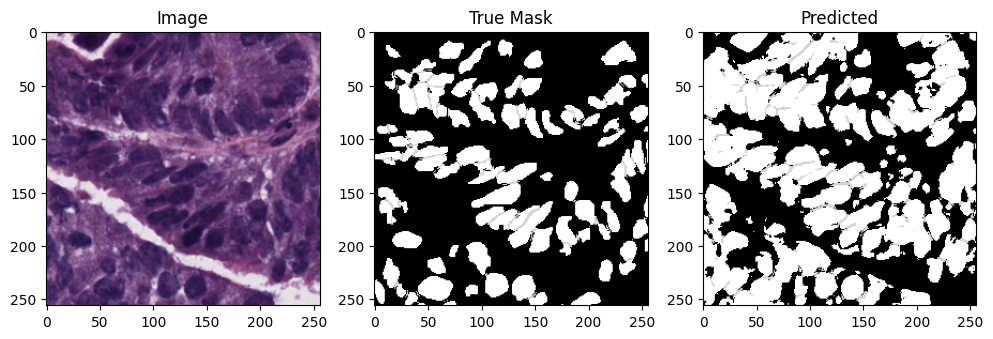

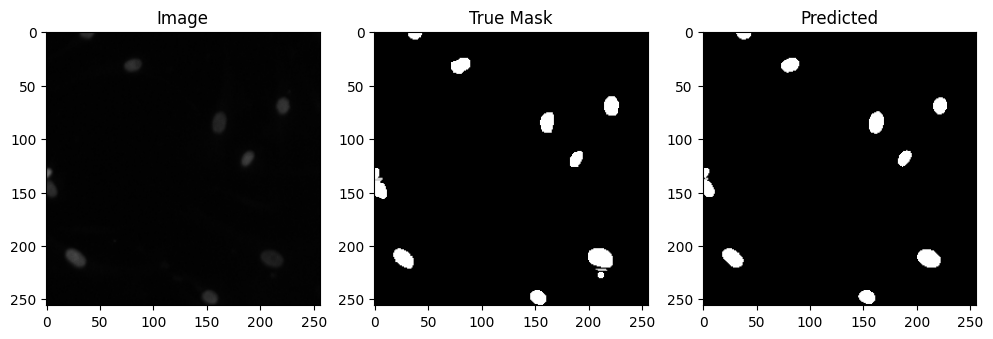

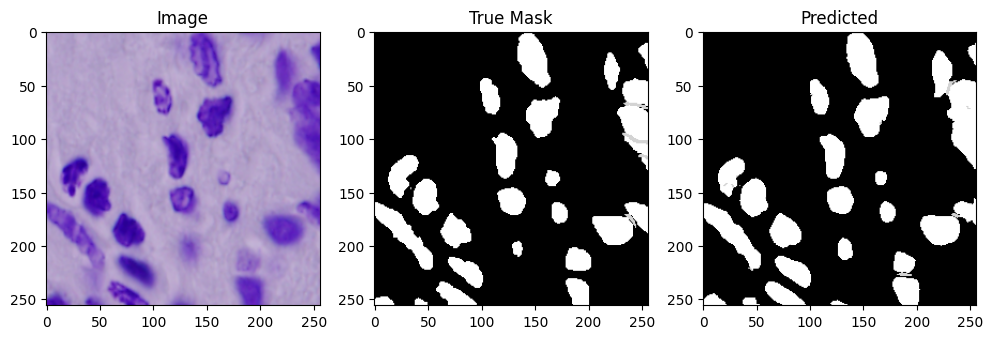

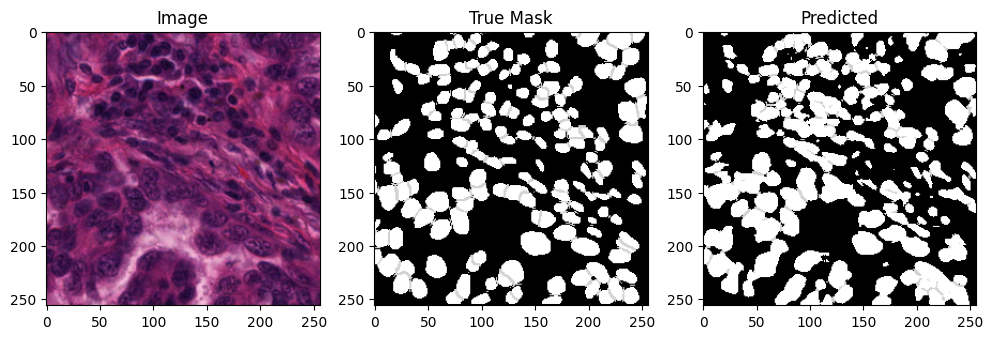

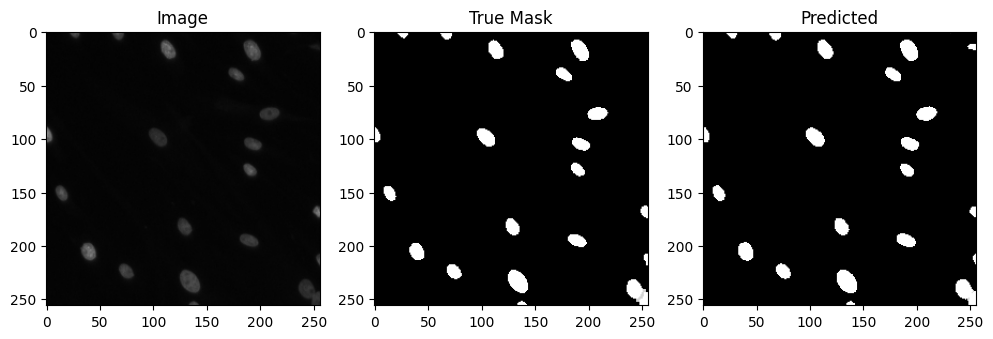

In [13]:
def visualize_by_index(model, val_set, idx, device):
    import matplotlib.pyplot as plt
    from matplotlib import colors

    model.eval()
    with torch.no_grad():
        # Get the image and mask at the given index
        image, mask = val_set[idx]   # image: [3,H,W], mask: [H,W]
        input_tensor = image.unsqueeze(0).to(device)  # [1,3,H,W]

        # Model prediction (no sigmoid)
        output = model(input_tensor)         # [1,3,H,W]
        pred_mask = torch.argmax(output, dim=1).cpu().numpy()[0]  # [H,W]

        img = image.cpu().numpy().transpose(1,2,0)
        mask = mask.cpu().numpy()

        # Custom colormap: 0=black, 1=white, 2=lightgray
        cmap = colors.ListedColormap(['black', 'white', 'lightgray'])

        plt.figure(figsize=(12,4))
        plt.subplot(1,3,1); plt.title('Image'); plt.imshow(img)
        plt.subplot(1,3,2); plt.title('True Mask'); plt.imshow(mask, cmap=cmap, vmin=0, vmax=2)
        plt.subplot(1,3,3); plt.title('Predicted'); plt.imshow(pred_mask, cmap=cmap, vmin=0, vmax=2)
        plt.show()


for i in range(150):
    # Example usage:
    visualize_by_index(model, val_set, idx=i, device=device)  # Show the 16th image in val_set
    i += 1


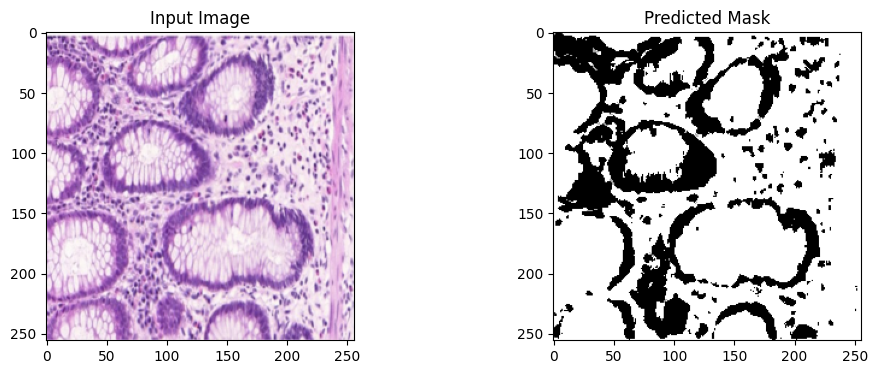

In [19]:
from PIL import Image
import torch
from torchvision import transforms
import numpy as np
import matplotlib.pyplot as plt
from matplotlib import colors

# Path to new image
new_img_path = r'G:\COMPUTER VISION\U-Net_Dataset\10462_2022_10372_Fig1_HTML.jpg'
img_size = 256

# Preprocessing
img = Image.open(new_img_path).convert("RGB")
transform = transforms.Compose([
    transforms.Resize((img_size, img_size)),
    transforms.ToTensor(),
])
input_img = transform(img).unsqueeze(0).to(device)

# Inference
model.eval()
with torch.no_grad():
    output = model(input_img)  # [1, 3, H, W]
    pred_mask = torch.argmax(output, dim=1).cpu().numpy()[0]  # [H,W]

# For display, use the preprocessed (resized) image:
img_resized = transform(img).permute(1,2,0).cpu().numpy()  # [H,W,3], values 0-1

# REVERSE: Background white, nucleus black, border dark gray
cmap = colors.ListedColormap(['white', 'black', 'darkgray'])

plt.figure(figsize=(12,4))
plt.subplot(1,2,1); plt.title('Input Image'); plt.imshow(img_resized)
plt.subplot(1,2,2); plt.title('Predicted Mask'); plt.imshow(pred_mask, cmap=cmap, vmin=0, vmax=2)
plt.show()